# Where's your city? PCA

In [63]:
from fastai import *
from fastai.vision import *
import fastai
import os
import random
from collections import defaultdict
import pandas as pd
import re
import umap
from sklearn.preprocessing import LabelEncoder
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
%matplotlib inline

In [8]:
torch.cuda.set_device(0)

In [9]:
path = Path('/home/henripal/projects/maps/scraper/')

In [10]:
path_img = path/'img'

In [13]:
data = ImageDataBunch.from_csv(path_img, ds_tfms=None, size=224, bs=64)
data.normalize(imagenet_stats)

In [14]:
learn = create_cnn(data, models.resnet50, metrics=error_rate)
learn.load('resnet50-big-finetuned-bs64')

ClassificationLearner(data=<fastai.vision.data.ImageDataBunch object at 0x7f34b8596550>, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        

In [15]:
layers = flatten_model(learn.model)

In [16]:
flatten_layer = layers[-8]

In [20]:
custom_hook = fastai.callbacks.hook_output(flatten_layer)

In [49]:
final_layer_activations = []
names = []
images = []
for i, (x, y) in enumerate(learn.data.train_dl):
    learn.model(x)
    images.append(x)
    final_layer_activations.append(custom_hook.stored.cpu().numpy())
    names.append(y.cpu().numpy())
    if i > 16: break


In [50]:
activations = np.vstack(final_layer_activations)
names = np.hstack(names)

In [55]:
images = [i.cpu().numpy() for i in images]

In [57]:
images = np.vstack(images)

In [72]:
images = np.moveaxis(images, 1, -1)

In [74]:
def normalize_image(i):
    return (i - np.min(i))/(np.max(i) - np.min(i))

In [79]:
names.shape, activations.shape, images.shape

((1152,), (1152, 4096), (1152, 224, 224, 3))

In [64]:
umap_maps = umap.UMAP()

In [65]:
U = umap_maps.fit_transform(activations)

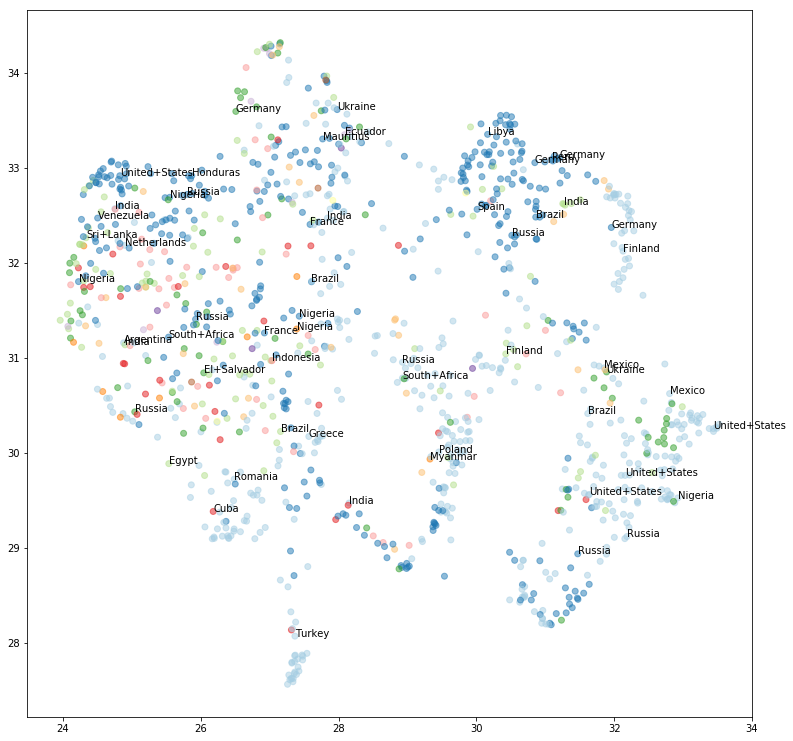

In [66]:
plt.figure(figsize=(13, 13))
plt.scatter(U[:,0], U[:,1], c=names, alpha=.5, cmap=plt.get_cmap("Paired"))
for i, name_idx in enumerate(names[::20]):
    plt.text(U[i, 0], U[i, 1], learn.data.classes[name_idx])

In [80]:
def visualize_scatter_with_images(X_2d_data, images, figsize=(45,45), image_zoom=1):
    fig, ax = plt.subplots(figsize=figsize)
    artists = []
    for xy, i in zip(X_2d_data, images):
        x0, y0 = xy
        img = OffsetImage(normalize_image(i), zoom=image_zoom)
        ab = AnnotationBbox(img, (x0, y0), xycoords='data', frameon=False)
        artists.append(ax.add_artist(ab))
    ax.update_datalim(X_2d_data)
    ax.autoscale()
    plt.show()
    

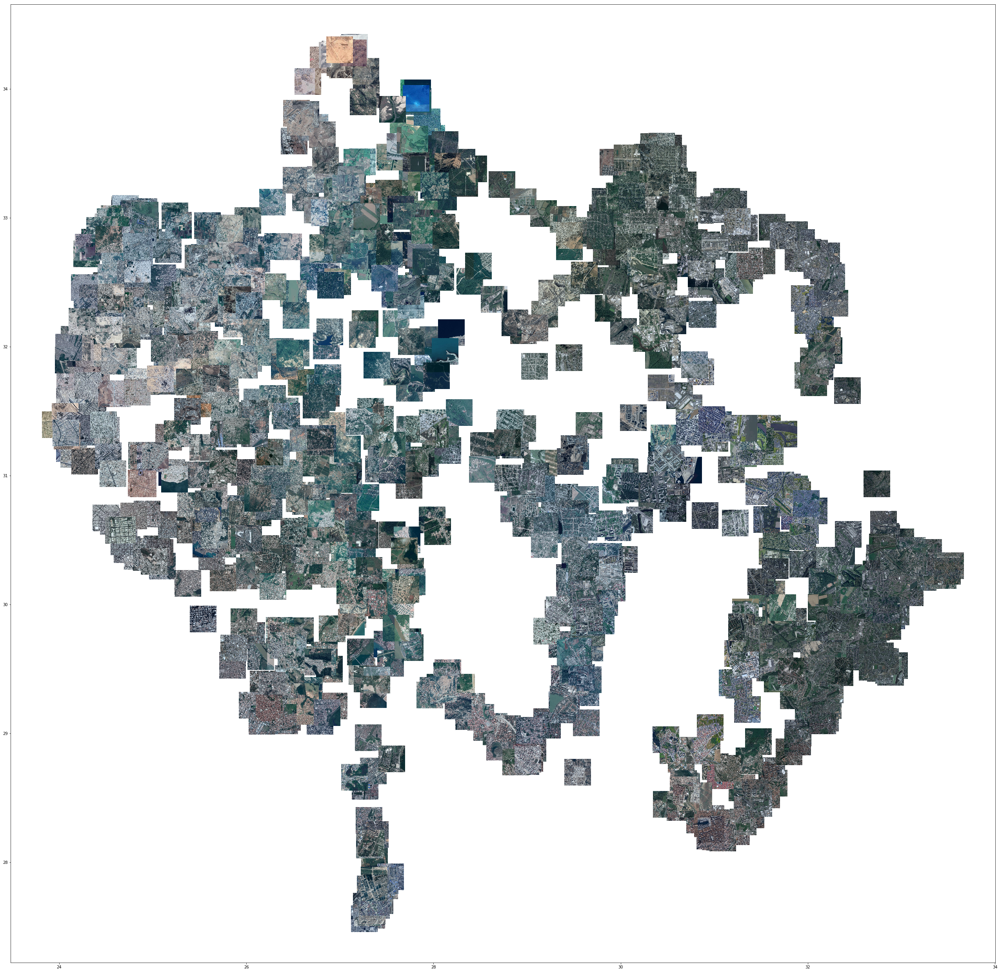

In [81]:
visualize_scatter_with_images(U, images, figsize=(45,45), image_zoom=.3)

In [89]:
from scipy.spatial.distance import cdist
size = 33
grid = np.dstack(np.meshgrid(np.linspace(0, 1, size), np.linspace(0, 1, size))).reshape(-1, 2)

In [84]:
from lapjv import lapjv

In [91]:
cost_matrix = cdist(grid, U[:(size*size)], "sqeuclidean").astype(np.float32)
cost_matrix = cost_matrix * (100000 / cost_matrix.max())
%time row_asses, col_asses, _ = lapjv(cost_matrix)

CPU times: user 1.99 s, sys: 53.4 ms, total: 2.05 s
Wall time: 633 ms


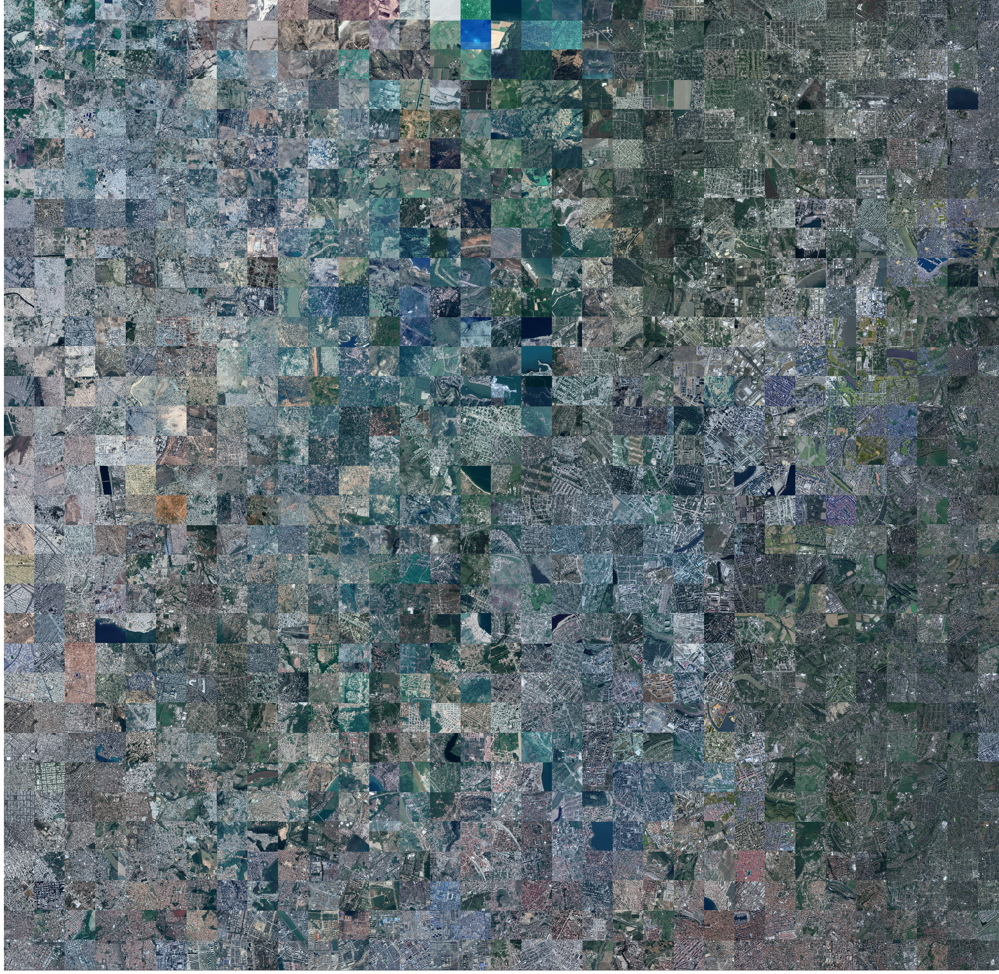

In [97]:
from PIL import Image

plt.rcParams["figure.figsize"] = (50, 50)
plt.gca().set_facecolor("black")
grid_jv = grid[col_asses]
for pos, img in zip(grid_jv, images):
    img = normalize_image(img) 
    #img = Image.fromarray(255 - img).resize((20, 20), Image.ANTIALIAS)
    ab = AnnotationBbox(OffsetImage(img, zoom=0.38),
                        pos * (size - 1) * 28, xycoords="data", frameon=False, box_alignment=(0, 0))
    plt.gca().add_artist(ab)
plt.xlim(0, (size - 1) * 28 + 16); plt.ylim(0, (size - 1) * 28 + 16)
plt.xticks([]); plt.yticks([])
plt.savefig('last.png')
